# Nandini Jaiswal
### MDS202335

This project was done as part of Final report in Applied Data Analytics course.


- You can find the report [here](https://docs.google.com/document/d/1YICDhLK4K3dxGcq0SGxrZIlMVroMwU_-iwZZqs9-TCg/edit?usp=sharing).

- The GitHub repository is maintained [here](https://github.com/Nandini-Jaiswal/Neural-multi-style-transfer.git).

- This project is done on Dec', 2024.

# Neural Style Transfer for Multiple Images

### What is it?

Style transfer (for multiple images) is the synthesis of images, creating an output that has the content of one image and the styles of  other images.

<img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/1-1.png" alt="drawing" width="300"/> <img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/1-2.png" alt="drawing" width="300"/> <img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/1-3.png" alt="drawing" width="300"/>
<img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/2-1.png" alt="drawing" width="300"/> <img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/2-2.png" alt="drawing" width="300"/> <img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/2-3.png" alt="drawing" width="300"/>
<img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/3-1.png" alt="drawing" width="300"/> <img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/3-2.png" alt="drawing" width="300"/> <img src="https://raw.githubusercontent.com/Nandini-Jaiswal/Neural-multi-style-transfer/main/assets/3-3.png" alt="drawing" width="300"/>

## How it Works

### Concept

The goal of neural style transfer is to minimize how different the content and style are between images. This involves taking the content of one image and blending it with the artistic style of others.

### Prerequisite Knowledge

#### Tensors
Tensors are multi-dimensional arrays, essential for storing data in neural networks. They allow the network to process and learn from the data efficiently.
- **Analogy**: Imagine one block equals one number. A row of these blocks is a vector. Stacking many rows of blocks on top of each other forms a matrix. Stacking many matrices results in a tensor.

#### GPUs vs. CPUs for Machine Learning
- **CPUs**: Good for tasks that require sequential computing and multi-threading.
- **GPUs**: Better suited for tasks that require parallel computing, like performing large scale matrix multiplications essential in neural networks.




# Cloning my git repository
I created a git repository to store the images which I will be using to try out my model so that I don't have to upload images to the colab notebook everytime I try to run the code

In [1]:
!git clone https://github.com/Nandini-Jaiswal/Neural-multi-style-transfer.git

Cloning into 'Neural-multi-style-transfer'...
remote: Enumerating objects: 122, done.
remote: Counting objects: 100% (122/122), done.
remote: Compressing objects: 100% (93/93), done.
remote: Total 122 (delta 33), reused 99 (delta 29), pack-reused 0 (from 0)
Receiving objects: 100% (122/122), 7.77 MiB | 16.79 MiB/s, done.
Resolving deltas: 100% (33/33), done.


# Storing style and content images in different lists
- The variable `image_dir` specifies the directory containing the images.
- Images whose filenames start with `'art'` are categorized as **style images**.
- Images whose filenames start with `'content'` are categorized as **content images**.
- The script outputs the list of style and content images for further processing.

In [2]:
import os
import glob

image_dir = 'Neural-multi-style-transfer/images'

styles = []
contents = []

for filename in glob.glob(os.path.join(image_dir, '*')):
    if filename.startswith(os.path.join(image_dir, 'art')):
        styles.append(filename)
    elif filename.startswith(os.path.join(image_dir, 'content')):
        contents.append(filename)

print("Style Images:", styles)
print("Content Images:", contents)

Style Images: ['Neural-multi-style-transfer/images/art7.webp', 'Neural-multi-style-transfer/images/art2.png', 'Neural-multi-style-transfer/images/art10.png', 'Neural-multi-style-transfer/images/art6.webp', 'Neural-multi-style-transfer/images/art9.png', 'Neural-multi-style-transfer/images/art1.png', 'Neural-multi-style-transfer/images/art8.jpg', 'Neural-multi-style-transfer/images/art5.webp', 'Neural-multi-style-transfer/images/art4.png', 'Neural-multi-style-transfer/images/art3.png']
Content Images: ['Neural-multi-style-transfer/images/content2.jpg', 'Neural-multi-style-transfer/images/content3.jpg', 'Neural-multi-style-transfer/images/content4.jpg', 'Neural-multi-style-transfer/images/content1.jpg', 'Neural-multi-style-transfer/images/content5.jpg']


# Model Architecture
1. **Pretrained VGG19**:  
   - The `vgg19` network, pretrained on ImageNet, is used as the backbone.  
   - Only its feature extraction layers are used (no classification layers).
   - The model is fine-tuned for NST tasks by extracting style and content representations.

2. **Normalization Layer**:  
   - A custom normalization layer (`Normalization`) is added to preprocess input images, matching the distribution of the pretrained VGG19.

3. **Content and Style Loss Layers**:  
   - **Content Loss**:  
     Compares the mean squared error (MSE) between the feature maps of the content image and the input.  
   - **Style Loss**:  
     Computes the Gram matrix of feature maps to capture style, applying weighted MSE loss between input and style target features.

4. **Wrap it up**:  
   - Layers are added sequentially to build the NST model.  
   - Stops adding layers after the last content or style loss to optimize memory usage and focus computations.

---

#### **Key Components**:

1. **Image Preprocessing**:  
   - Input images are resized and converted into tensors.
   - Normalization ensures compatibility with the VGG19 model.

2. **Style and Content Layers**:  
   - Style is extracted from layers `conv_1` to `conv_5`.
   - Content is extracted from layer `conv_4`.

3. **Gram Matrix**:  
   - Used to compute correlations in feature maps, essential for capturing texture and style.

4. **Loss Function**:  
   - Combines weighted style and content losses:
    
    **Total Loss** = (Style Weight × Style Loss) + (Content Weight × Content Loss)



5. **Optimization**:  
   - Input image is optimized using **LBFGS** to minimize total loss over multiple iterations.

6. **Output Image**:  
   - The transformed image (combining style and content) is generated after `num_steps` of optimization.

---



In [8]:
import torch
import random
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torchvision.models import vgg19, VGG19_Weights
import copy
from tqdm.notebook import tqdm

### Set global variables:
- We are downsizing images if GPU is not available.
- We are also using pretrained `vgg19` as `cnn`.

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
torch.set_default_device(device)

# Downsize the image if GPU is not available
imsize = 512 if torch.cuda.is_available() else 128

unloader = transforms.ToPILImage()

# pretrained VGG network
cnn = vgg19(weights=VGG19_Weights.DEFAULT).features.to(device).eval()

# normalization of mean and standard deviation of RGB
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:07<00:00, 78.9MB/s]


### Define `utility functions` for loading and viewing images.

In [5]:
def load_images(image_paths, imsize):
    images = []
    for image_path in image_paths:
        image = Image.open(image_path).convert('RGB')
        image = transforms.Resize((imsize, imsize))(image)
        image = transforms.ToTensor()(image).unsqueeze(0)
        images.append(image.to(device, torch.float))
    return images

def imshow(tensor, title=None):
    image = tensor.cpu().clone()
    image = image.squeeze(0)
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

## Necessary components of the `NST` model:
1. **Content Loss**  
   - Measures how similar the **content** of the input is to the target content image using **Mean Squared Error (MSE)**.  
   - The `target` is detached from the computational graph to prevent updates during optimization.

2. **Gram Matrix**  
   - Calculates a matrix that captures **style features** by measuring correlations between feature maps.  
   - Normalizes by the number of elements to ensure consistent scaling.

3. **Style Loss**  
   - Measures the difference in **style** between the input and target images using MSE between their Gram matrices.  
   - Weights are applied to balance contributions from different layers.

4. **Normalization Layer**  
   - Normalizes images using pre-defined **mean** and **standard deviation** to match the distribution expected by the pretrained VGG network.

These components enable NST by computing and balancing **content** and **style losses** during optimization.

In [6]:
class ContentLoss(nn.Module):
    def __init__(self, target):
        super(ContentLoss, self).__init__()
        self.target = target.detach()

    def forward(self, input):
        self.loss = F.mse_loss(input, self.target)
        return input

def gram_matrix(input):
    a, b, c, d = input.size()
    features = input.view(a * b, c * d)
    G = torch.mm(features, features.t())
    return G.div(a * b * c * d)

class StyleLoss(nn.Module):
    def __init__(self, target_features):
        super(StyleLoss, self).__init__()
        self.targets = [gram_matrix(target).detach() for target in target_features]
        self.weights = [1.0 / len(target_features)] * len(target_features)

    def forward(self, input):
        G = gram_matrix(input)
        self.loss = sum([F.mse_loss(G, target) * weight for target, weight in zip(self.targets, self.weights)])
        return input



class Normalization(nn.Module):
    def __init__(self, mean, std):
        super(Normalization, self).__init__()
        self.mean = mean.view(-1, 1, 1)
        self.std = std.view(-1, 1, 1)

    def forward(self, img):
        return (img - self.mean) / self.std

## Brief Explanation of Style Transfer Pipeline

#### **1. `get_style_model_and_losses`**
- Builds a model by copying the layers of a pretrained VGG network, adding:
  - **Normalization layer** at the start.
  - **Content and Style Loss modules** at specified layers.
- Extracts:
  - **Content losses** by comparing features of the content image.
  - **Style losses** by computing Gram matrices for style images at each specified layer.
- Trims the model after the last loss layer to improve efficiency.

---

#### **2. `get_input_optimizer`**
- Configures the optimizer to update the **input image** rather than the model's weights.
- Uses **L-BFGS** (a memory-efficient optimization algorithm) for minimizing the combined style and content loss.

---

#### **3. `run_style_transfer`**
- **Steps**:
  1. Builds the style transfer model with loss modules using `get_style_model_and_losses`.
  2. Optimizes the input image:
     - Iteratively adjusts pixel values to minimize style and content loss.
     - Uses **clamping** to ensure pixel values remain valid (between 0 and 1).
  3. Tracks and prints the **Style Loss** and **Content Loss** during optimization.
- **Weights**:
  - `style_weight`: Controls how much emphasis is placed on style matching.
  - `content_weight`: Controls how much content is preserved.

---

### **Pipeline Summary**
- Prepares a model to compute **style** and **content losses**.
- Uses **L-BFGS** to optimize the input image iteratively.
- Balances the style and content contributions to create the final stylized image.

In [7]:
def get_style_model_and_losses(cnn, normalization_mean, normalization_std, style_imgs, content_img):
    normalization = Normalization(normalization_mean, normalization_std)
    content_losses = []
    style_losses = []
    model = nn.Sequential(normalization)
    i = 0

    for layer in cnn.children():
        if isinstance(layer, nn.Conv2d):
            i += 1
            name = 'conv_{}'.format(i)
        elif isinstance(layer, nn.ReLU):
            name = 'relu_{}'.format(i)
            layer = nn.ReLU(inplace=False)
        elif isinstance(layer, nn.MaxPool2d):
            name = 'pool_{}'.format(i)
        elif isinstance(layer, nn.BatchNorm2d):
            name = 'bn_{}'.format(i)
        else:
            raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

        model.add_module(name, layer)

        if name in content_layers_default:
            target = model(content_img).detach()
            content_loss = ContentLoss(target)
            model.add_module("content_loss_{}".format(i), content_loss)
            content_losses.append(content_loss)

        if name in style_layers_default:
            target_features = [model(style_img).detach() for style_img in style_imgs]
            style_loss = StyleLoss(target_features)
            model.add_module("style_loss_{}".format(i), style_loss)
            style_losses.append(style_loss)

    for i in range(len(model) - 1, -1, -1):
        if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
            break

    model = model[:(i + 1)]

    return model, style_losses, content_losses

def get_input_optimizer(input_img):
    optimizer = optim.LBFGS([input_img.requires_grad_()])
    return optimizer

def run_style_transfer(
    cnn,
    normalization_mean,
    normalization_std,
    content_img,
    style_imgs,
    input_img,
    num_steps=300,
    style_weight=100000,
    content_weight=1,
):
    """Run the style transfer."""
    print("Building the style transfer model..")
    model, style_losses, content_losses = get_style_model_and_losses(
        cnn, normalization_mean, normalization_std, style_imgs, content_img
    )

    optimizer = get_input_optimizer(input_img)

    print("Optimizing..")
    run = [0]
    while run[0] <= num_steps:

        def closure():
            # correct the values of updated input image using 'clamp'
            with torch.no_grad():
                input_img.data = input_img.data.clamp(0, 1)

            optimizer.zero_grad()
            model(input_img)
            style_score = 0
            content_score = 0

            for sl in style_losses:
                style_score += sl.loss
            for cl in content_losses:
                content_score += cl.loss

            loss = style_score * style_weight + content_score * content_weight
            loss.backward()

            run[0] += 1
            if run[0] % 150 == 0:
                print("run {}:".format(run))
                print(
                    "Style Loss : {:4f} Content Loss: {:4f}".format(
                        style_score.item(), content_score.item()
                    )
                )
            return loss

        optimizer.step(closure)

    with torch.no_grad():
        input_img.data = input_img.data.clamp(0, 1)

    return input_img

# Trying out all the styles for all the content images
- Here I have iterated through each of the styles and generated the output for every content image using that style image.
- Every style image was combined with every content image and the output target image was generated.

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000072 Content Loss: 37.260651
run [300]:
Style Loss : 0.000022 Content Loss: 34.367046




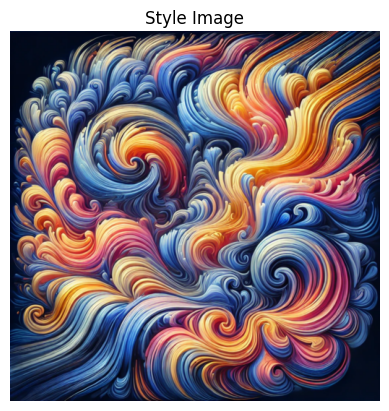

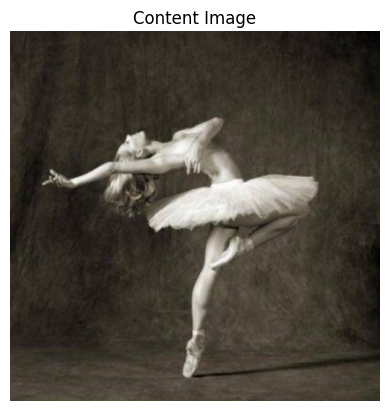

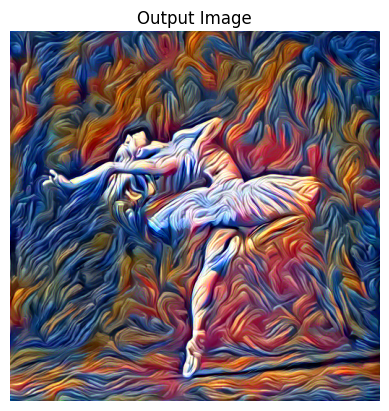


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000082 Content Loss: 35.714905
run [300]:
Style Loss : 0.000024 Content Loss: 32.745705




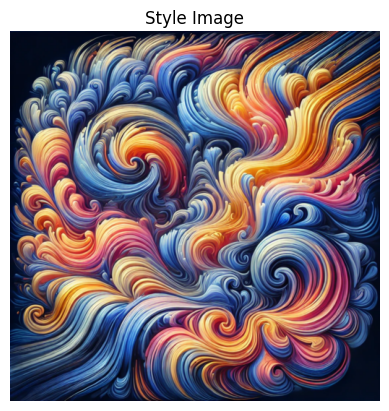

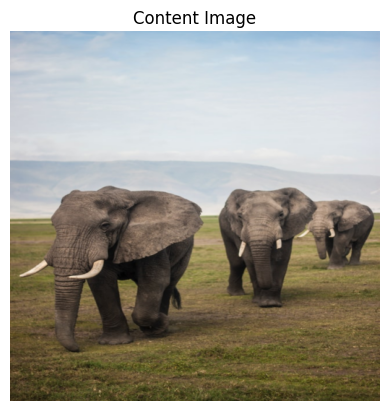

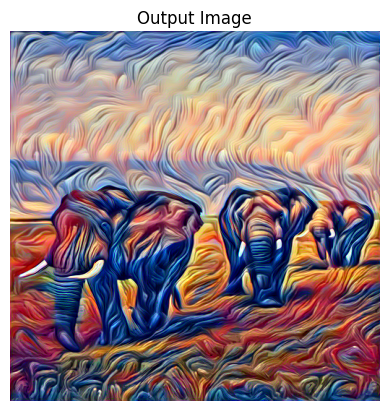


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000049 Content Loss: 38.000118
run [300]:
Style Loss : 0.000024 Content Loss: 35.230255




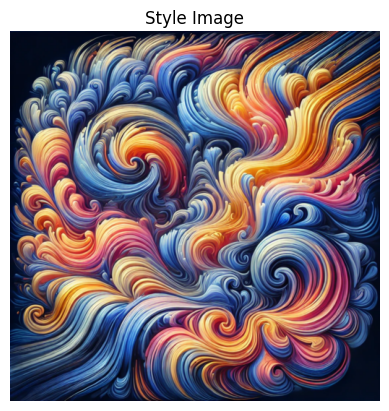

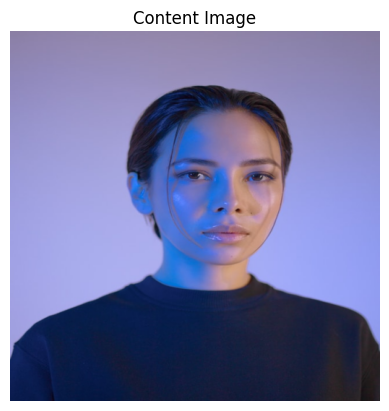

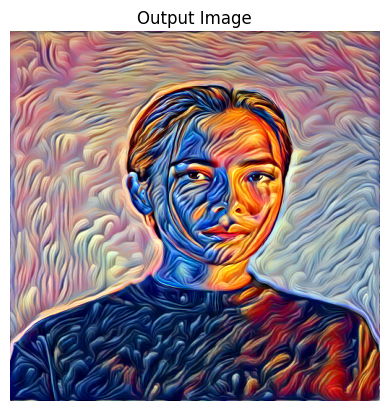


----End of iteration----




  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000048 Content Loss: 64.371582
run [300]:
Style Loss : 0.000018 Content Loss: 59.937691




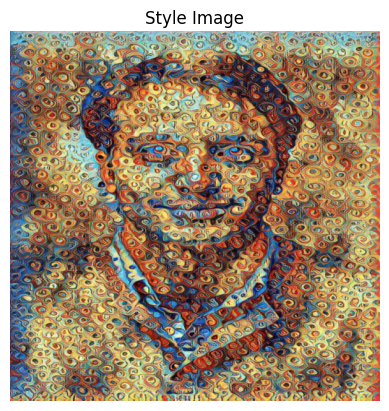

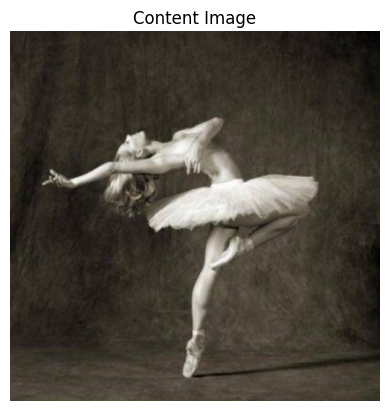

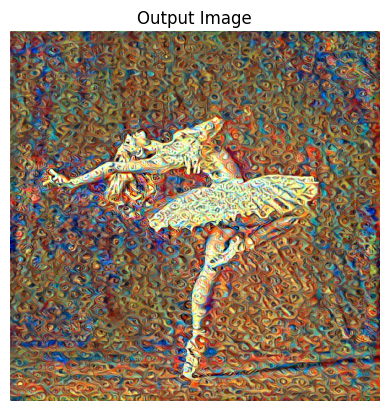


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000046 Content Loss: 63.143448
run [300]:
Style Loss : 0.000024 Content Loss: 55.721607




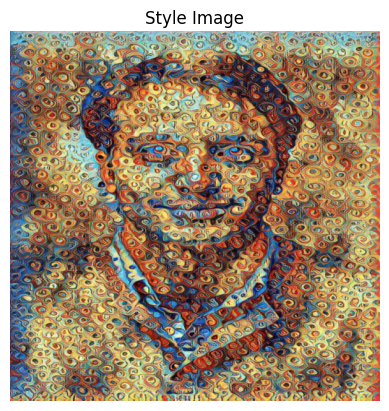

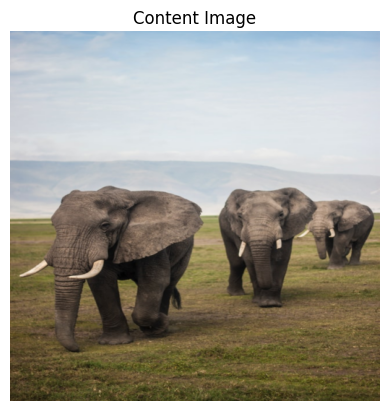

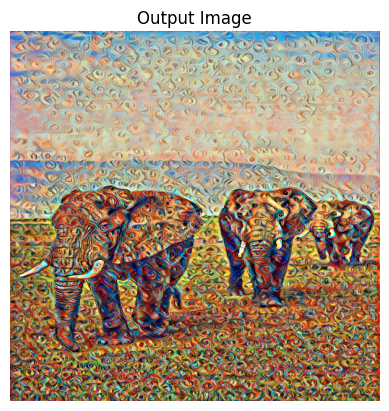


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000042 Content Loss: 54.072670
run [300]:
Style Loss : 0.000021 Content Loss: 48.939831




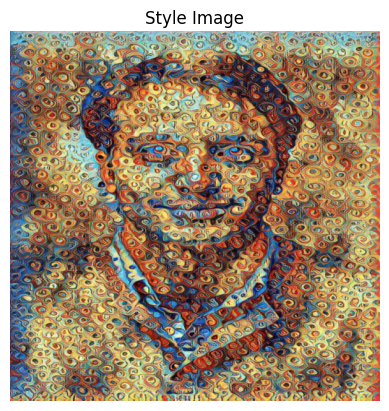

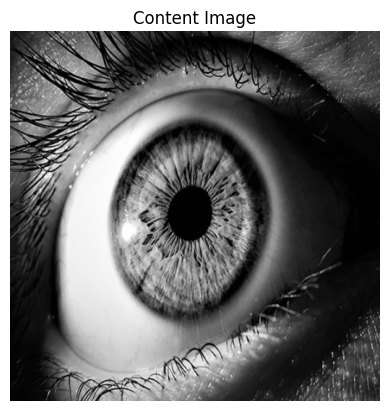

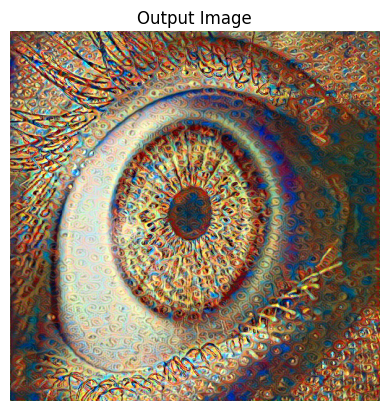


----End of iteration----




  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000040 Content Loss: 11.043242
run [300]:
Style Loss : 0.000010 Content Loss: 9.513079




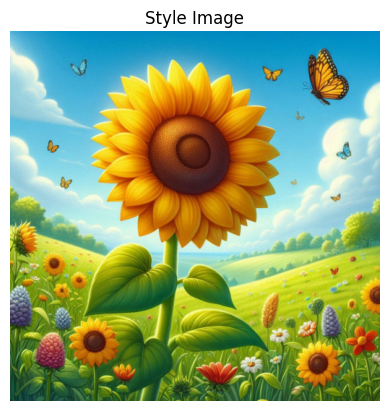

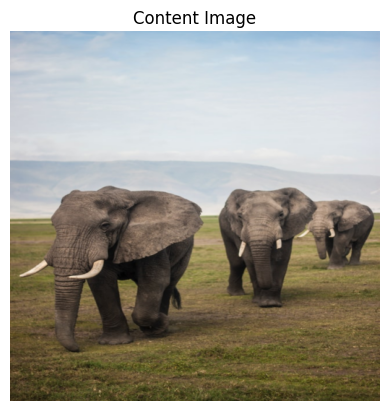

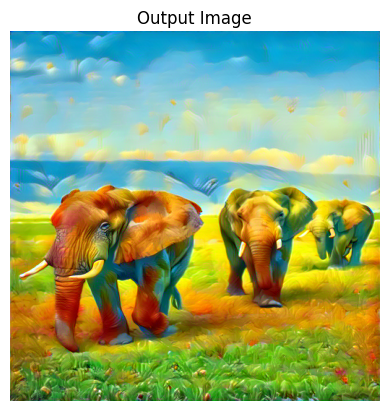


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000083 Content Loss: 13.824016
run [300]:
Style Loss : 0.000027 Content Loss: 9.912479




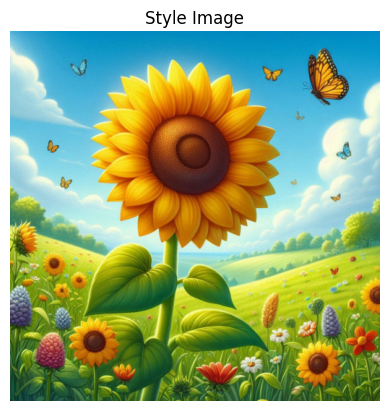

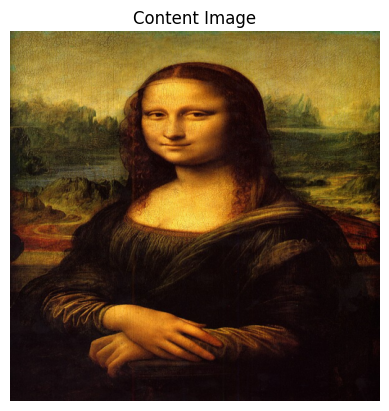

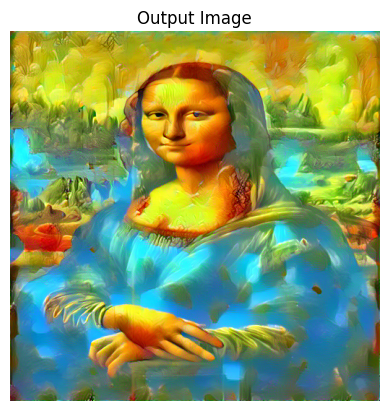


----End of iteration----




  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000034 Content Loss: 44.784325
run [300]:
Style Loss : 0.000014 Content Loss: 41.164360




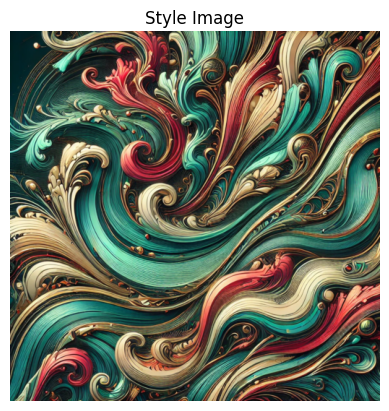

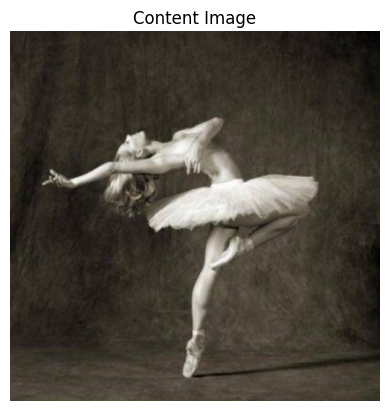

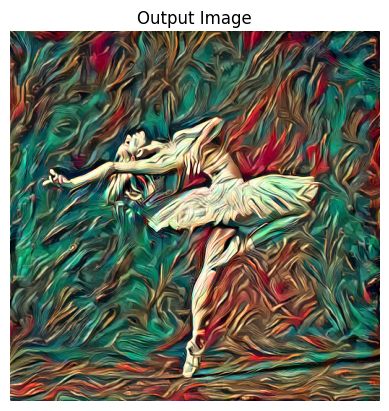


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000034 Content Loss: 40.225052
run [300]:
Style Loss : 0.000015 Content Loss: 34.106285




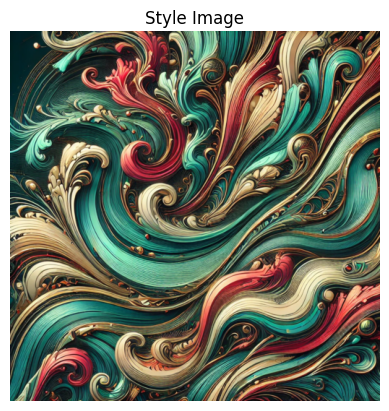

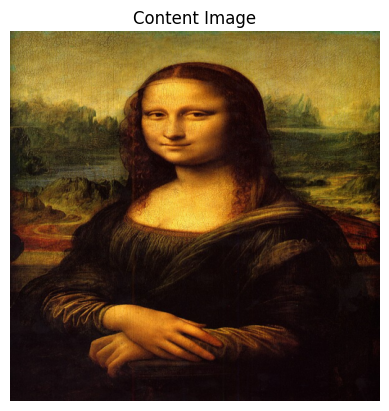

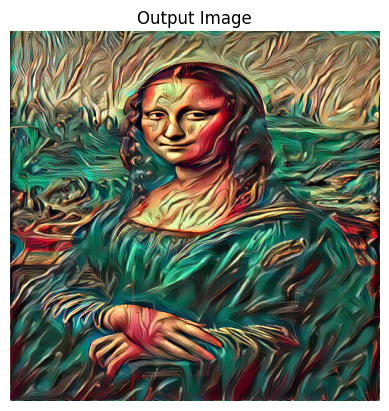


----End of iteration----




  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000076 Content Loss: 26.393217
run [300]:
Style Loss : 0.000024 Content Loss: 24.548237




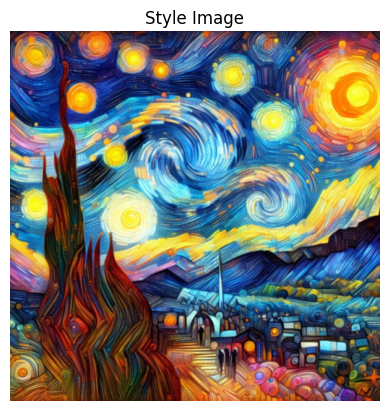

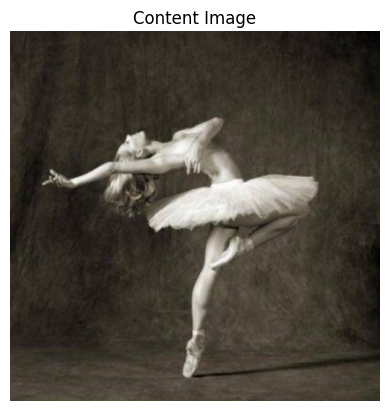

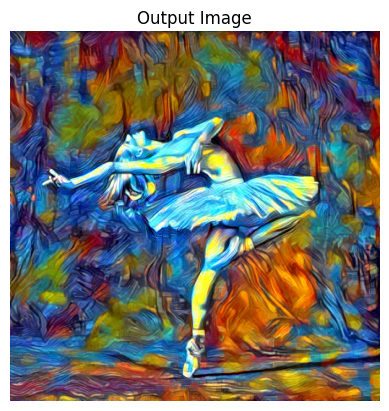


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000053 Content Loss: 19.684071
run [300]:
Style Loss : 0.000016 Content Loss: 16.983191




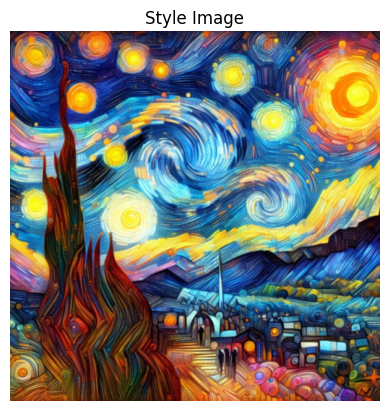

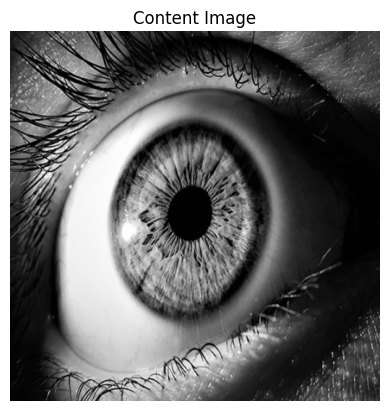

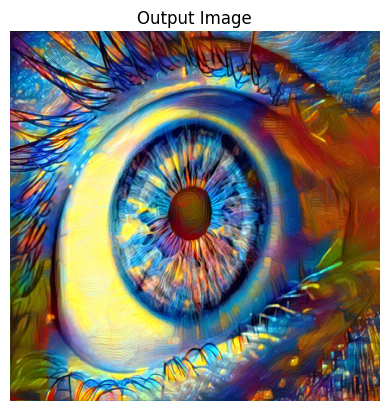


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000031 Content Loss: 19.588261
run [300]:
Style Loss : 0.000013 Content Loss: 16.754276




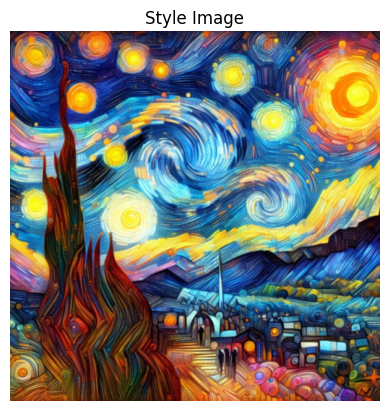

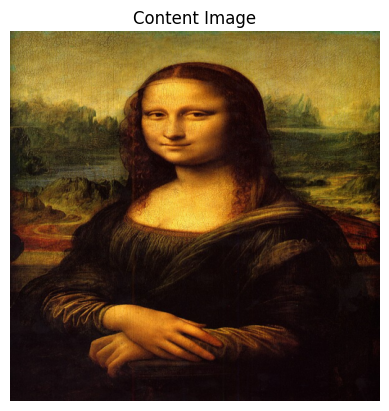

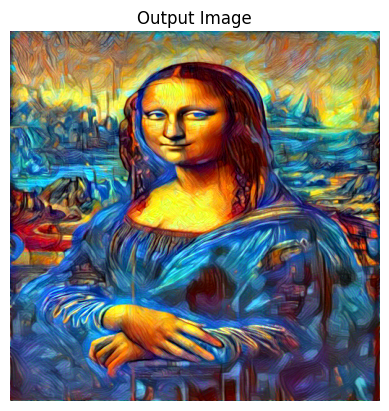


----End of iteration----




  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000156 Content Loss: 63.817833
run [300]:
Style Loss : 0.000039 Content Loss: 58.405762




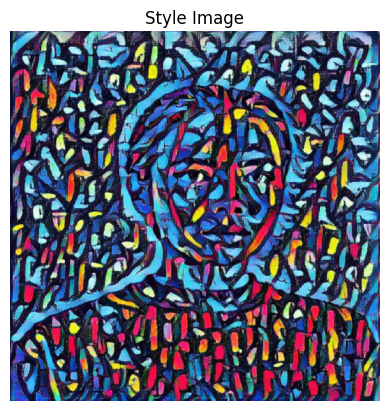

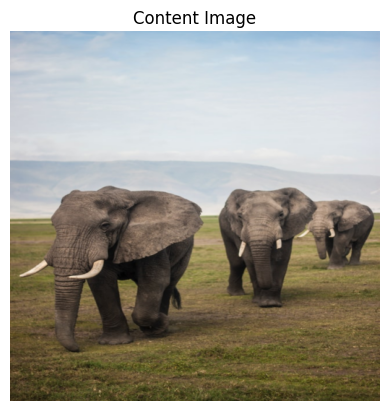

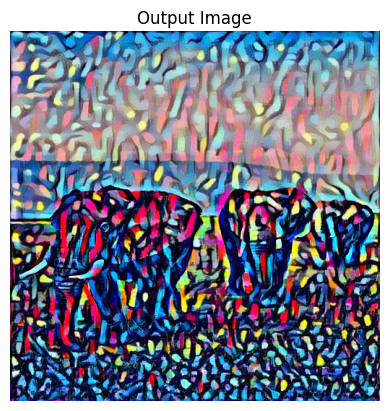


----End of iteration----




  0%|          | 0/5 [00:00<?, ?it/s]


----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000002 Content Loss: 1.862594
run [300]:
Style Loss : 0.000002 Content Loss: 1.815288




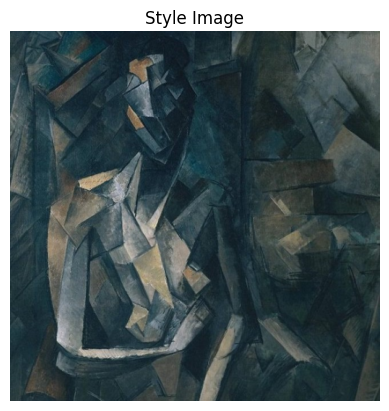

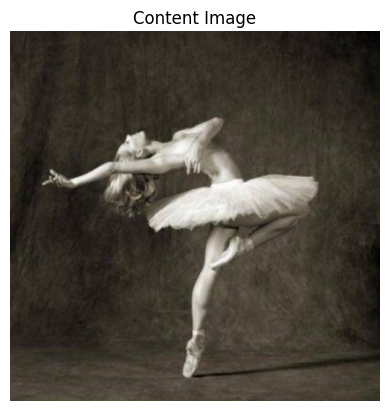

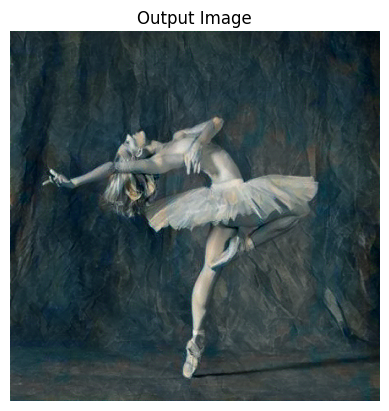


----End of iteration----



----New iteration----

Building the style transfer model..
Optimizing..
run [150]:
Style Loss : 0.000009 Content Loss: 4.520845
run [300]:
Style Loss : 0.000005 Content Loss: 4.336869




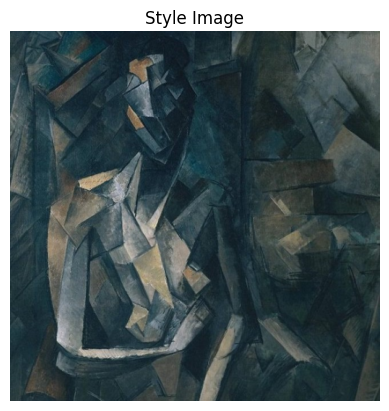

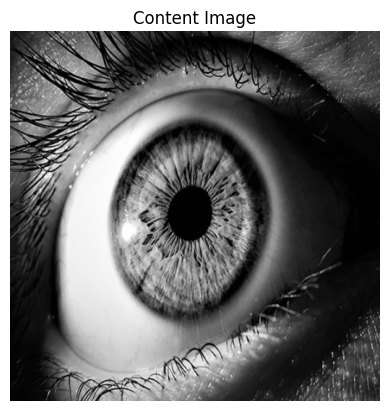

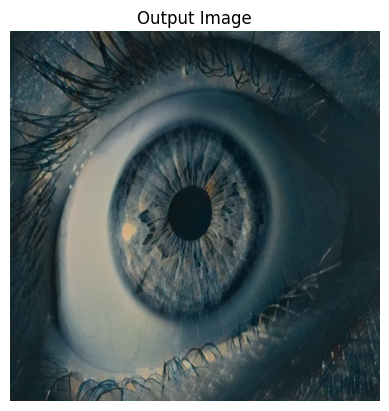


----End of iteration----




In [9]:
for style_image in tqdm(styles[:7]):
    for content_image in tqdm(contents):

        if random.random() < 0.49:
          continue

        style_imgs = load_images([style_image], imsize)
        content_img = load_images([content_image], imsize)[0]

        unloader = transforms.ToPILImage()

        print("\n----New iteration----\n")
        plt.ion()

        input_img = content_img.clone()
        output = run_style_transfer(
            cnn,
            cnn_normalization_mean,
            cnn_normalization_std,
            content_img,
            style_imgs,
            input_img,
        )

        print("\n")

        plt.ion()

        # display the images
        for i, style_img in enumerate(style_imgs):
            plt.figure()
            plt.axis("off")
            imshow(style_img, title=f'Style Image')

        plt.figure()
        plt.axis("off")
        imshow(content_img, title='Content Image')

        plt.figure()
        plt.axis("off")
        imshow(output, title='Output Image')
        plt.ioff()
        plt.show()
        print("\n----End of iteration----")
        print("\n")

# Multi Neural Style Transfer

Now, we will see that our model extends to even transferring multiple neural styles to a single image.

Building the style transfer model..
Optimizing..
run [50]:
Style Loss : 0.006864 Content Loss: 15.706420
run [100]:
Style Loss : 0.006747 Content Loss: 14.607373
run [150]:
Style Loss : 0.006735 Content Loss: 13.492344
run [200]:
Style Loss : 0.006729 Content Loss: 13.019403
run [250]:
Style Loss : 0.006723 Content Loss: 12.846786
run [300]:
Style Loss : 0.006718 Content Loss: 12.751980




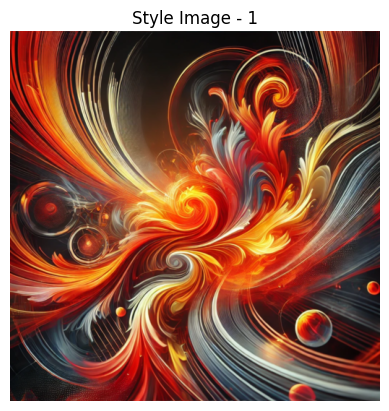

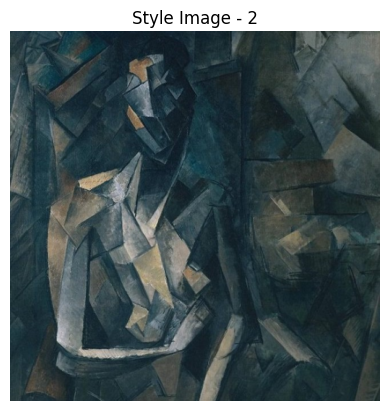

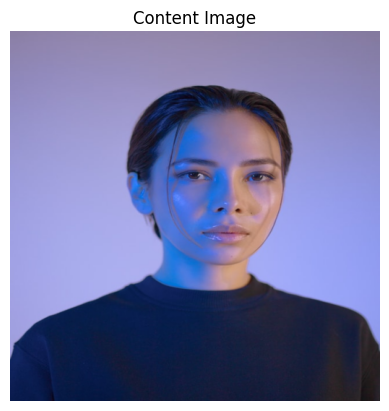

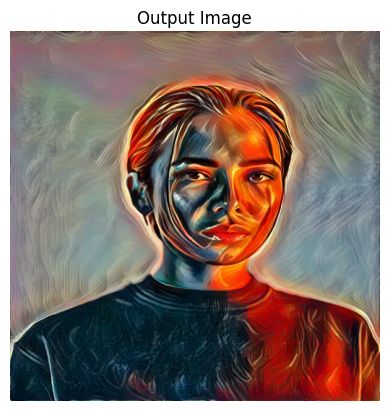

In [ ]:
import random

style_image_paths = random.sample(styles, 2)
style_imgs = load_images(style_image_paths, imsize)

content_image_path = random.choice(contents)
content_img = load_images([content_image_path], imsize)[0]

input_img = content_img.clone()
output = run_style_transfer(
    cnn,
    cnn_normalization_mean,
    cnn_normalization_std,
    content_img,
    style_imgs,
    input_img,
)

print("\n")

# display the images
for i, style_img in enumerate(style_imgs):
  plt.figure()
  plt.axis("off")
  imshow(style_img, title=f'Style Image - {i+1}')

plt.figure()
plt.axis("off")
imshow(content_img, title='Content Image')

plt.figure()
plt.axis("off")
imshow(output, title='Output Image')
plt.ioff()
plt.show()

Building the style transfer model..
Optimizing..
run [50]:
Style Loss : 0.019776 Content Loss: 5.921240
run [100]:
Style Loss : 0.019744 Content Loss: 5.019145
run [150]:
Style Loss : 0.019738 Content Loss: 4.649691
run [200]:
Style Loss : 0.019736 Content Loss: 4.465050
run [250]:
Style Loss : 0.019734 Content Loss: 4.362514
run [300]:
Style Loss : 0.019734 Content Loss: 4.304535




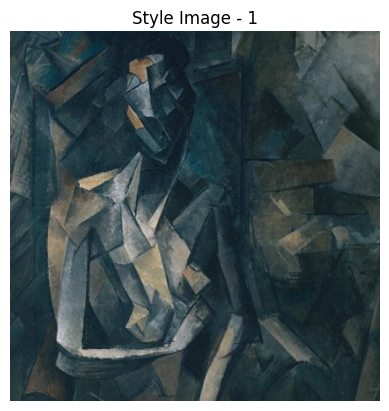

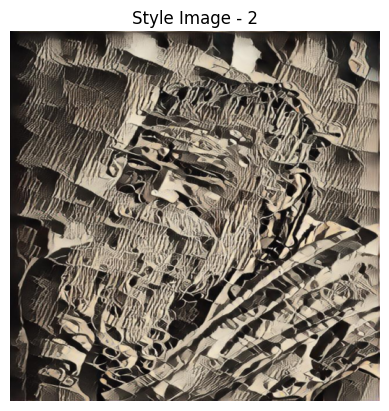

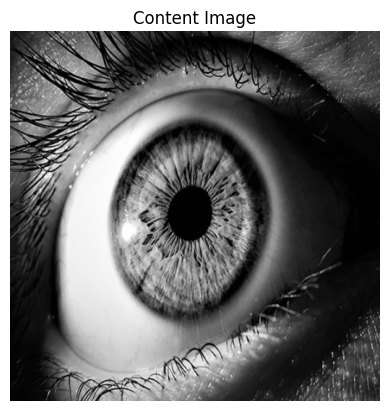

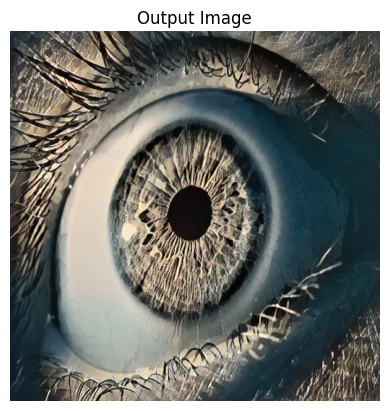

In [ ]:
import random

style_image_paths = random.sample(styles, 2)
style_imgs = load_images(style_image_paths, imsize)

content_image_path = random.choice(contents)
content_img = load_images([content_image_path], imsize)[0]

input_img = content_img.clone()
output = run_style_transfer(
    cnn,
    cnn_normalization_mean,
    cnn_normalization_std,
    content_img,
    style_imgs,
    input_img,
)

print("\n")

# display the images
for i, style_img in enumerate(style_imgs):
  plt.figure()
  plt.axis("off")
  imshow(style_img, title=f'Style Image - {i+1}')

plt.figure()
plt.axis("off")
imshow(content_img, title='Content Image')

plt.figure()
plt.axis("off")
imshow(output, title='Output Image')
plt.ioff()
plt.show()

Building the style transfer model..
Optimizing..
run [50]:
Style Loss : 0.010329 Content Loss: 36.405464
run [100]:
Style Loss : 0.010093 Content Loss: 33.174526
run [150]:
Style Loss : 0.010027 Content Loss: 31.207588
run [200]:
Style Loss : 0.010001 Content Loss: 29.933504
run [250]:
Style Loss : 0.009994 Content Loss: 28.867710
run [300]:
Style Loss : 0.009988 Content Loss: 28.311638




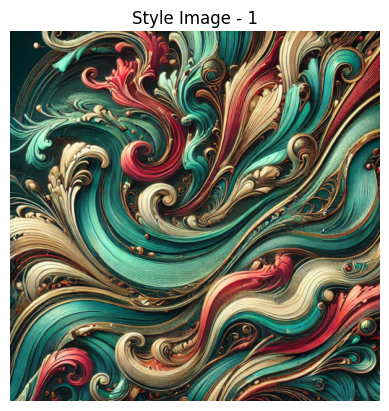

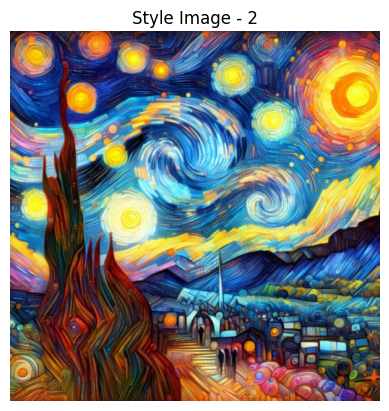

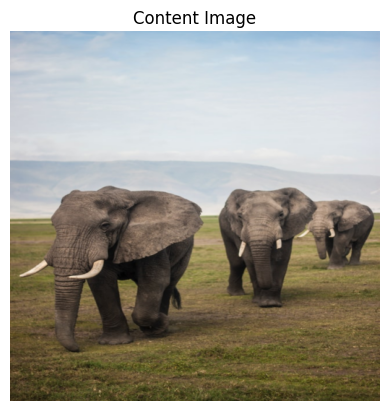

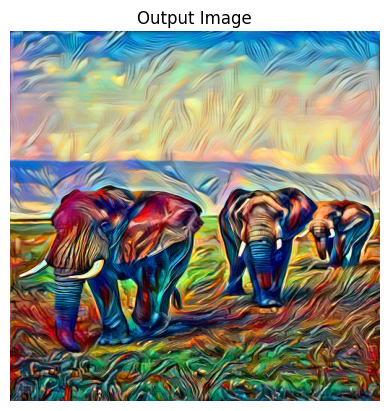

In [ ]:
import random

style_image_paths = random.sample(styles, 2)
style_imgs = load_images(style_image_paths, imsize)

content_image_path = random.choice(contents)
content_img = load_images([content_image_path], imsize)[0]

input_img = content_img.clone()
output = run_style_transfer(
    cnn,
    cnn_normalization_mean,
    cnn_normalization_std,
    content_img,
    style_imgs,
    input_img,
)

print("\n")

# display the images
for i, style_img in enumerate(style_imgs):
  plt.figure()
  plt.axis("off")
  imshow(style_img, title=f'Style Image - {i+1}')

plt.figure()
plt.axis("off")
imshow(content_img, title='Content Image')

plt.figure()
plt.axis("off")
imshow(output, title='Output Image')
plt.ioff()
plt.show()